In [3]:
import cv2
import glob
import matplotlib.pyplot as plt
import numpy as np

from camera import corners_unwarp
from camera import warp_birds_eye
from camera import Calibration

from window import find_window_centroids
from window import sliding_window

from lane_line_tracker import LaneLineTracker

from thresholding import get_edge_mask

%matplotlib inline

# Checkerboard grid pattern
PATTERN_SIZE=(9, 6)
N_WINDOWS=9

# Input image width and height
W = 1280
H = 720

# Perspective transform source and desetination points
SOURCE_POINTS = np.float32([
    [-100, H], 
    [W / 2 - 76, H * .625], 
    [W / 2 + 76, H * .625], 
    [W + 100, H]
])
DESTINATION_POINTS = np.float32([
    [100, H], 
    [100, 0], 
    [W - 100, 0],
    [W - 100, H]
])

### Collect Calibration Parameters

In [13]:
calibration = Calibration('../camera_cal/calibration*.jpg', PATTERN_SIZE, 'calibration.p', output_status=True)
calibration.calibrate()

Loaded saved calibration file


### Show Undistorted Images - Calibration

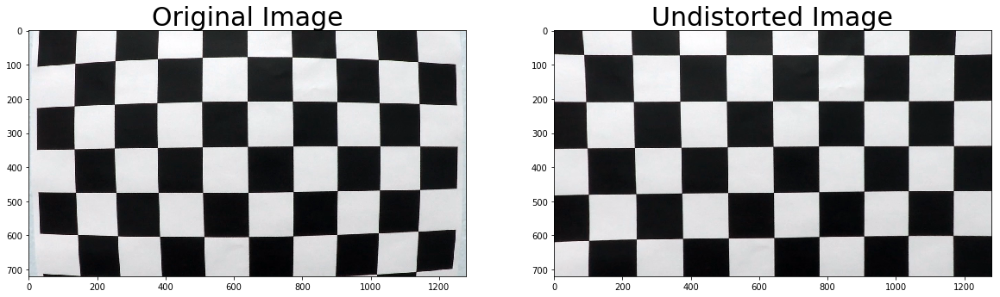

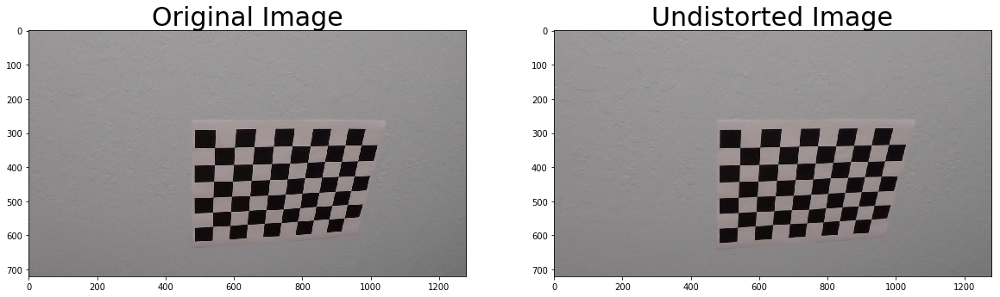

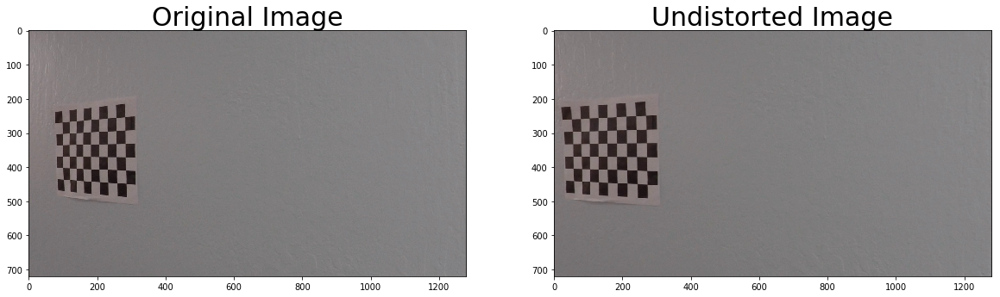

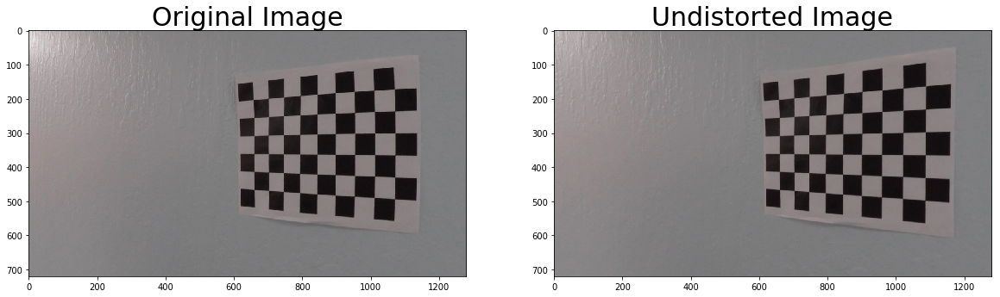

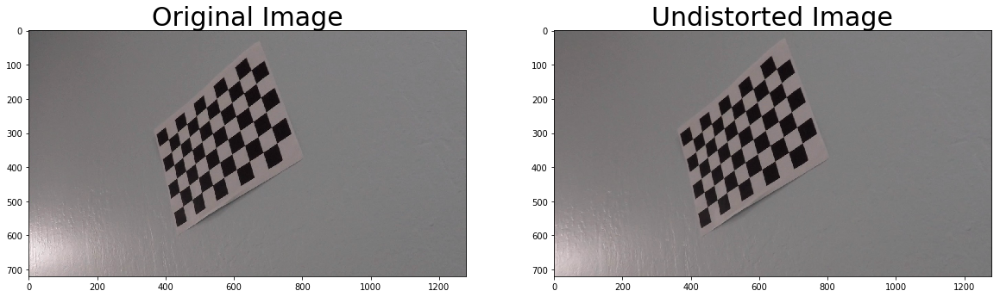

...

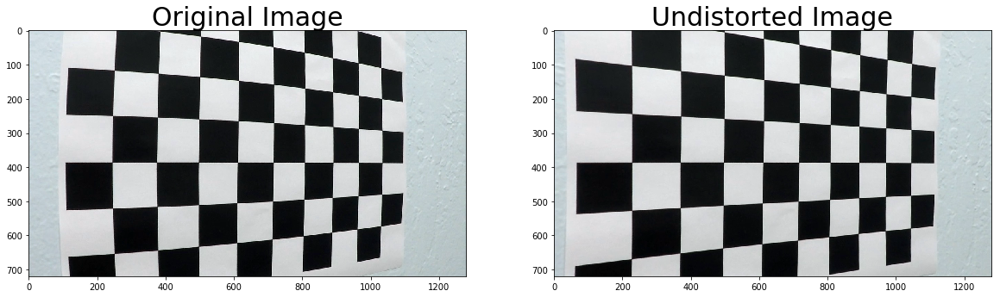

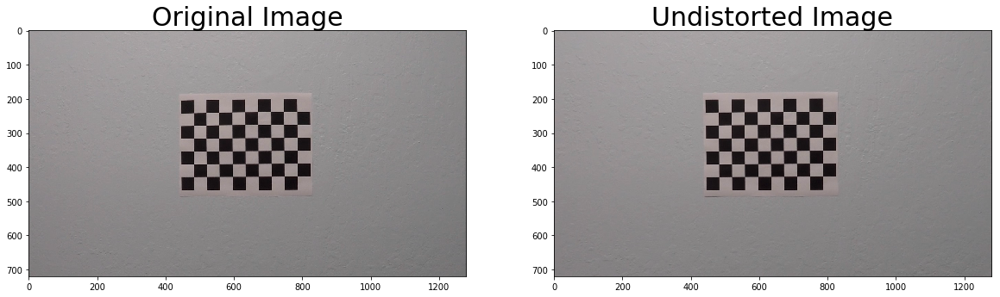

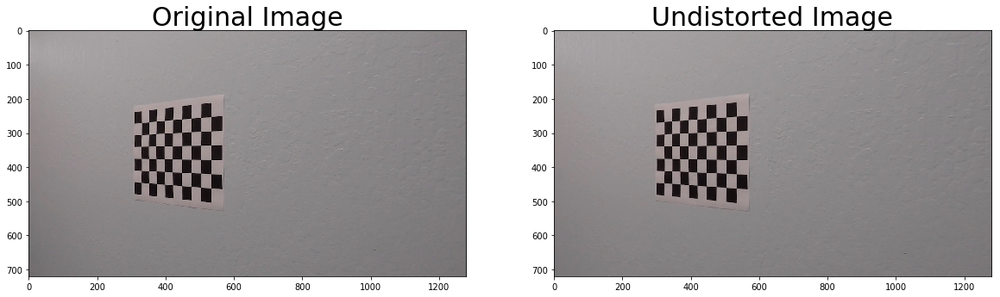

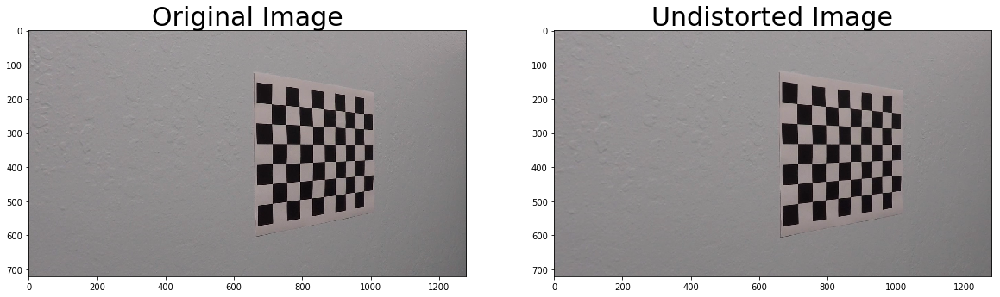

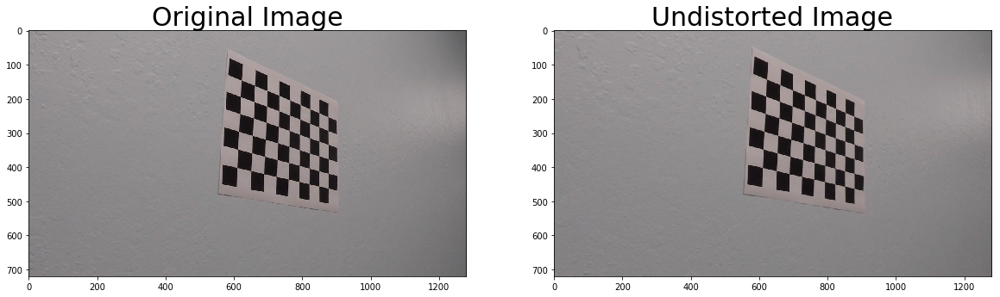

In [19]:
for index, filename in enumerate(glob.glob(calibration.images_glob)):
    img = cv2.imread(filename)    
    undist = cv2.undistort(
        img, 
        calibration.camera_matrix, 
        calibration.distortion_coefficients, 
        None, 
        calibration.camera_matrix
    )
    
    if undist is None:
        continue

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=30)

### Show Undistorted Images - Test

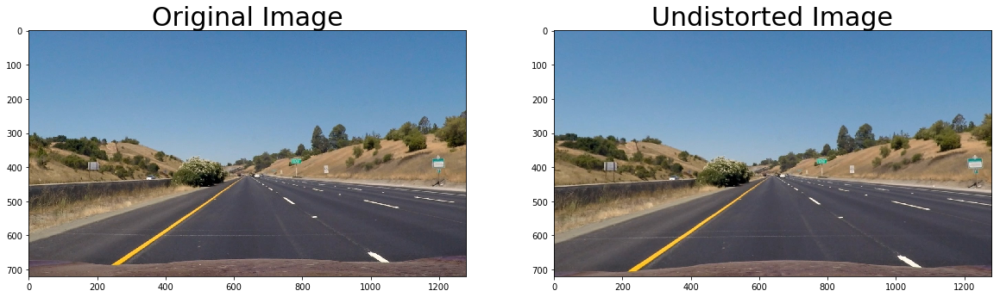

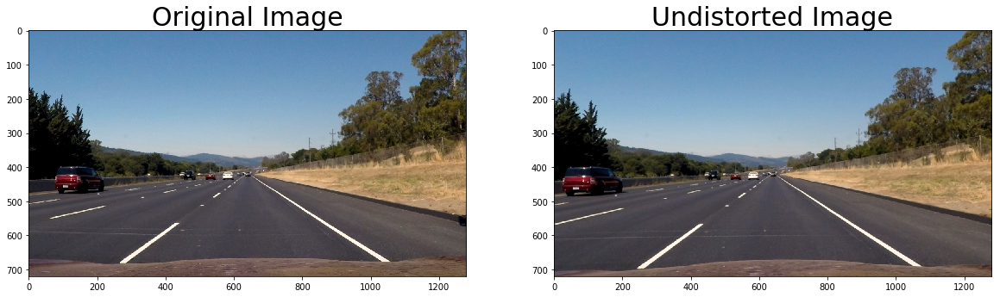

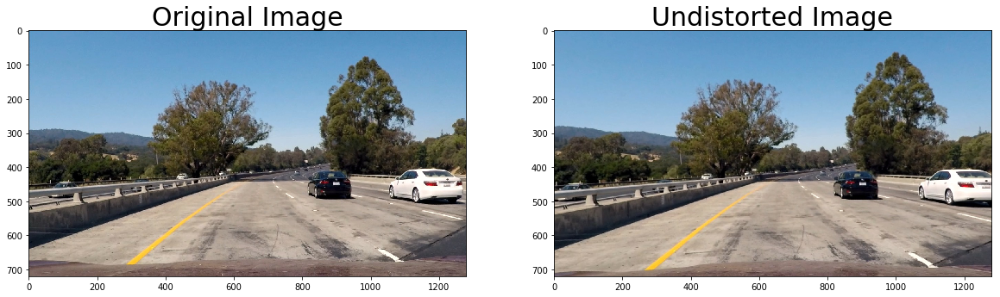

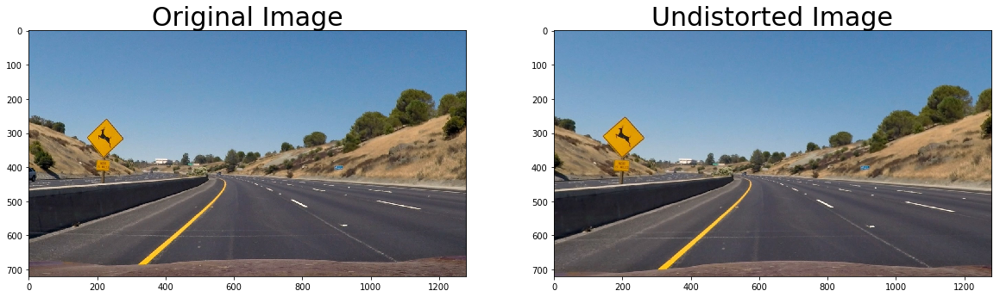

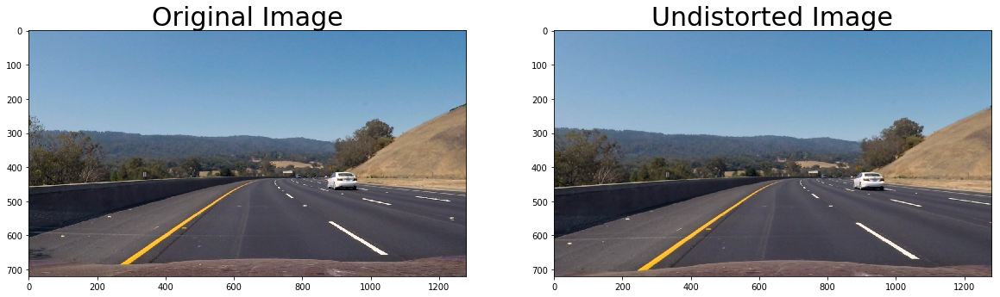

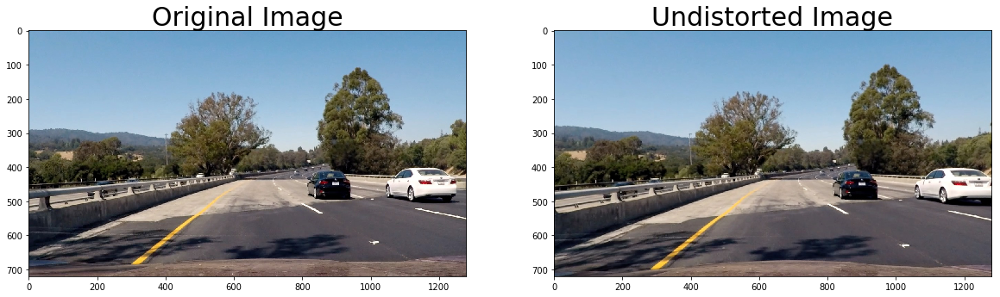

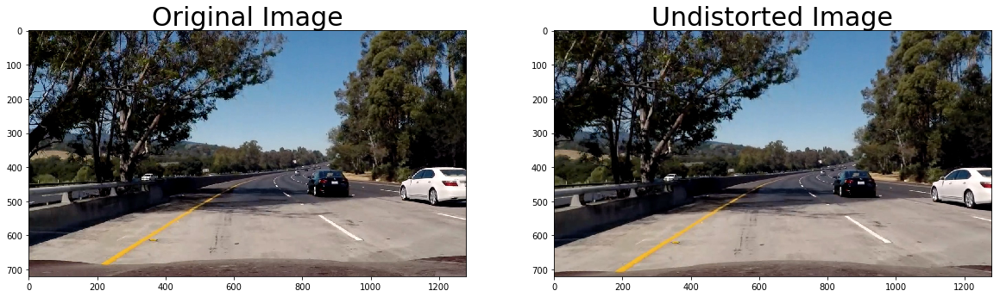

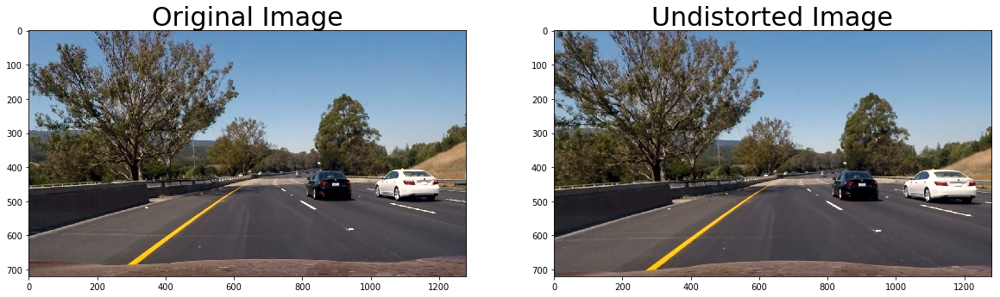

In [21]:
for index, filename in enumerate(glob.glob('../test_images/*.jpg')):
    img = cv2.imread(filename)    
    undist = cv2.undistort(
        img, 
        calibration.camera_matrix, 
        calibration.distortion_coefficients, 
        None, 
        calibration.camera_matrix
    )
    
    if undist is None:
        continue

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image', fontsize=30)

### Plot Calibration Images with Perspective Shift

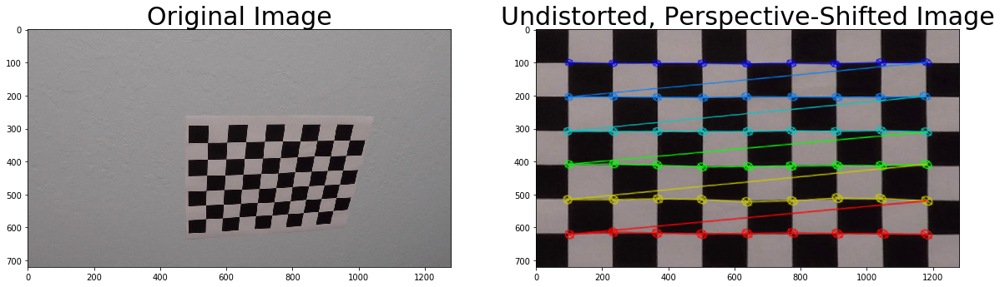

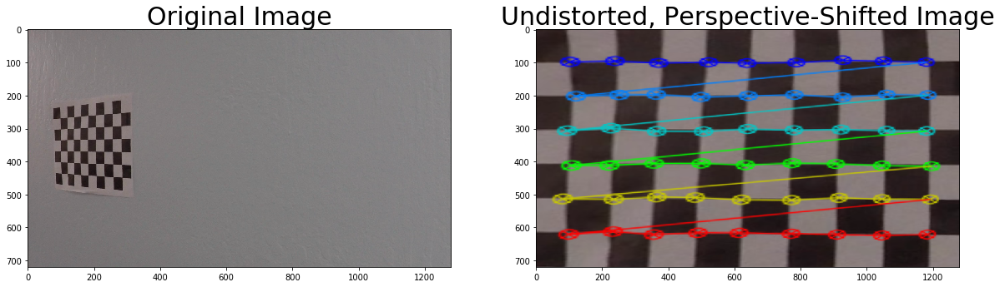

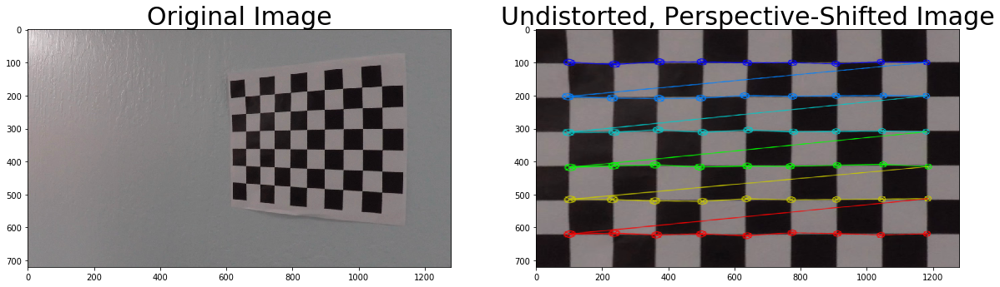

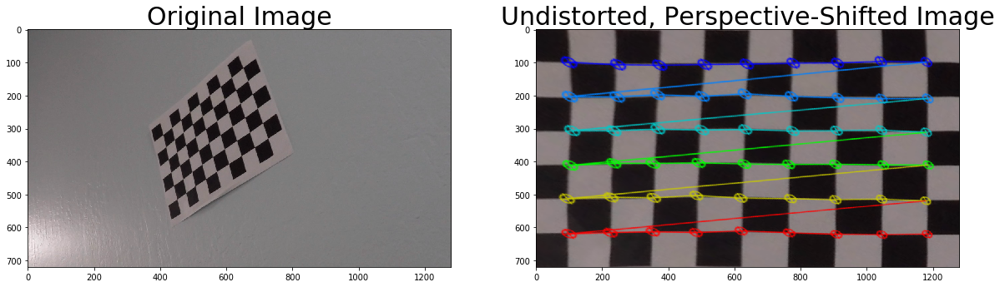

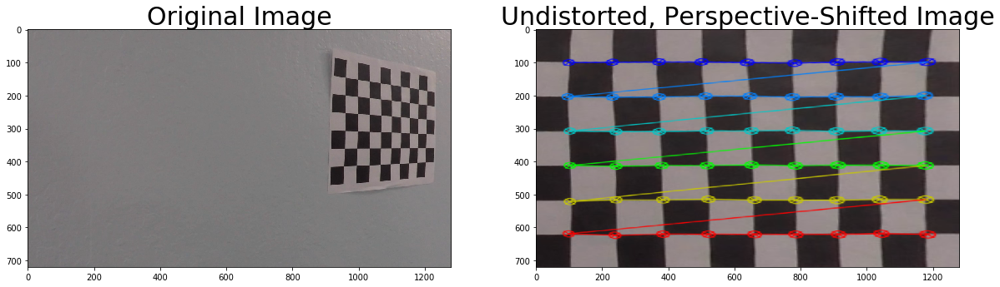

...

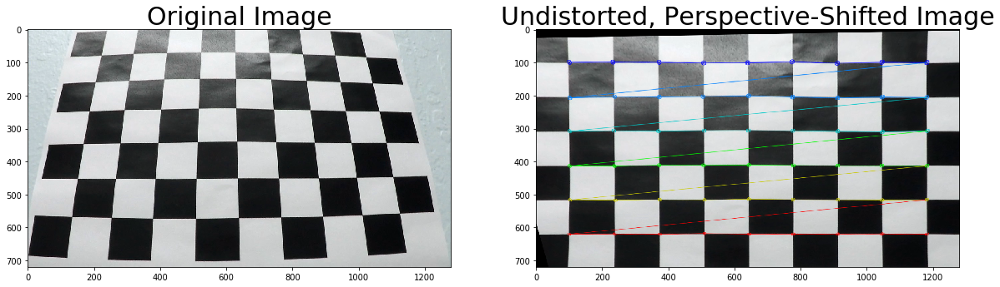

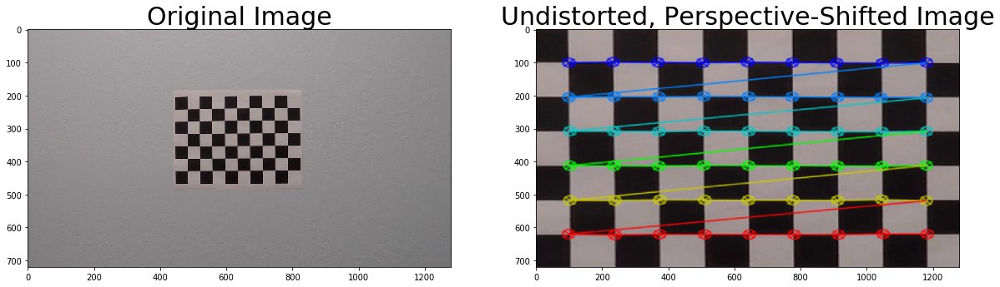

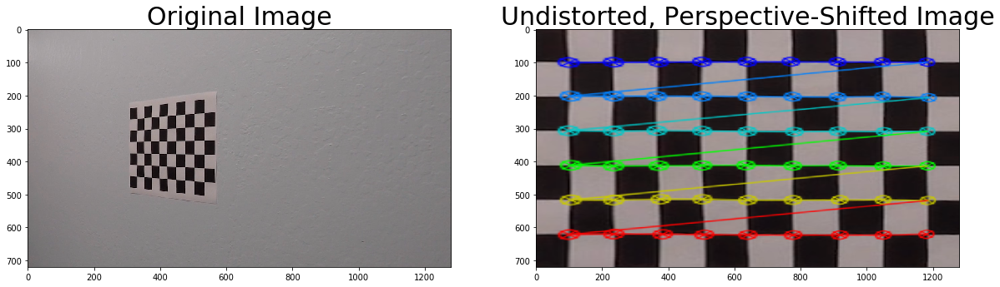

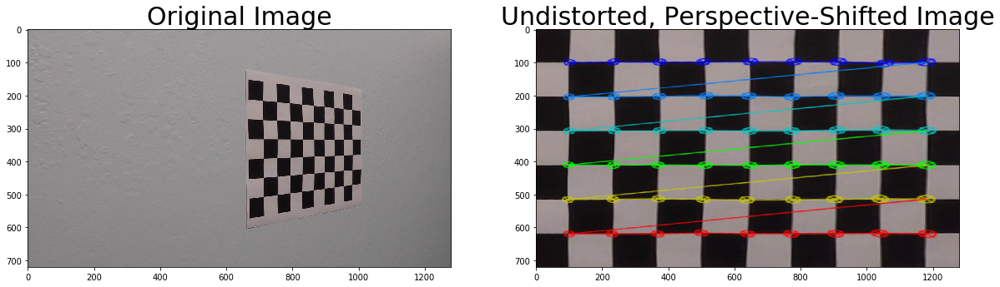

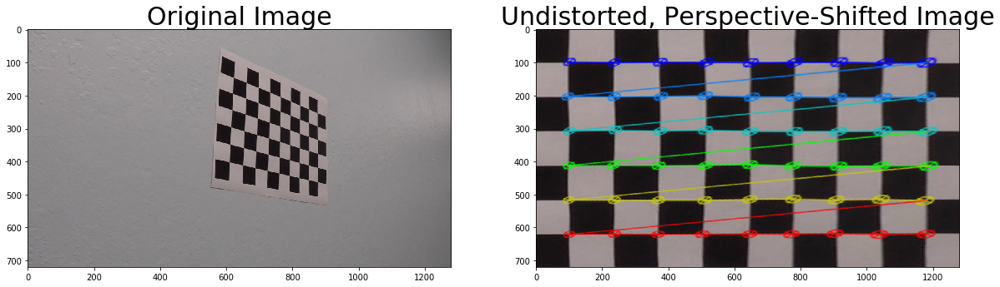

In [11]:
for index, filename in enumerate(glob.glob(calibration.images_glob)):
    img = cv2.imread(filename)
    warped, M = corners_unwarp(
        img, 
        PATTERN_SIZE[0], 
        PATTERN_SIZE[1], 
        calibration.camera_matrix, 
        calibration.distortion_coefficients
    )
    
    if warped is None:
        continue
        
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(warped)
    ax2.set_title('Undistorted, Perspective-Shifted Image', fontsize=30)

### Demonstrate Perspective Shift

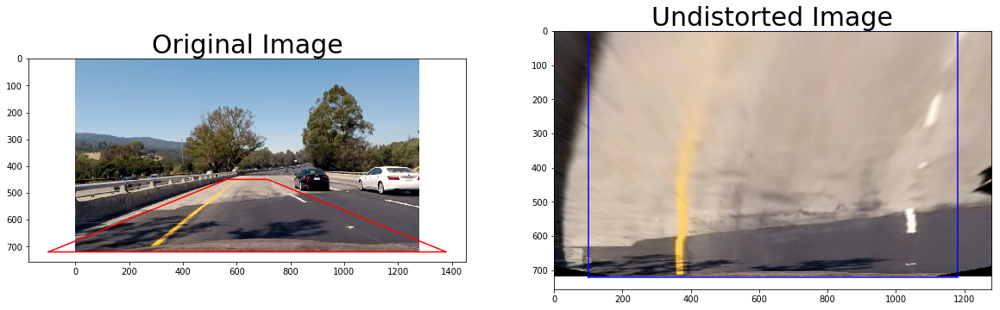

In [9]:
filename = 'test4'
image = cv2.imread('../test_images/' + filename + '.jpg')
undistorted = cv2.undistort(image, calibration.camera_matrix, calibration.distortion_coefficients, None)
transformed_image = warp_birds_eye(
    undistorted, 
    source_points=SOURCE_POINTS, 
    destination_points=DESTINATION_POINTS
)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))

# Draw source and destination shapes as cloesd polygons
source_points = np.concatenate( (SOURCE_POINTS, SOURCE_POINTS[:1]), axis=0 )
destination_points = np.concatenate( (DESTINATION_POINTS, DESTINATION_POINTS[:1]), axis=0 )

ax1.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
ax1.plot(*zip(*source_points), 'r-')
ax2.imshow(cv2.cvtColor(transformed_image, cv2.COLOR_BGR2RGB))
ax2.plot(*zip(*destination_points), 'b-')

ax1.set_title('Original Image', fontsize=30)
ax2.set_title('Undistorted Image', fontsize=30)

### Lane Line Detection Thresholding

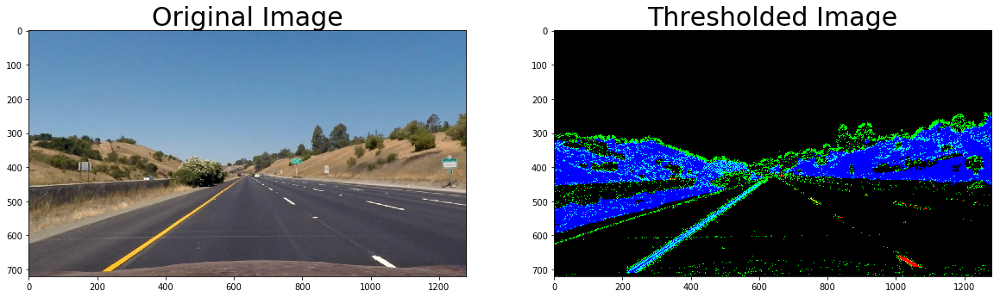

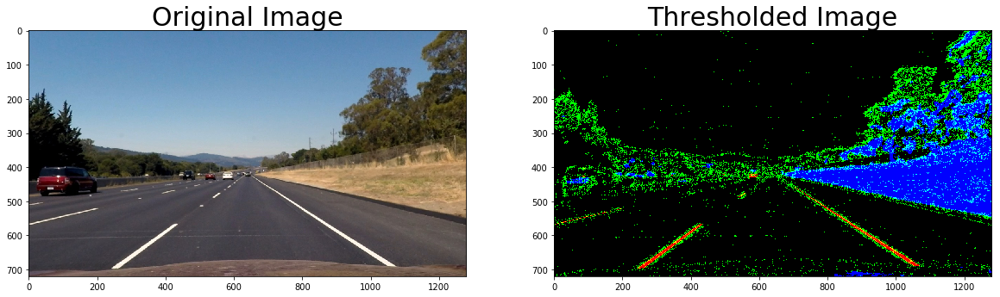

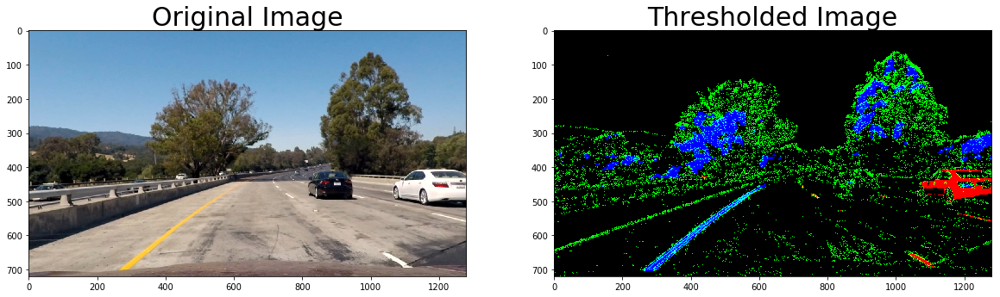

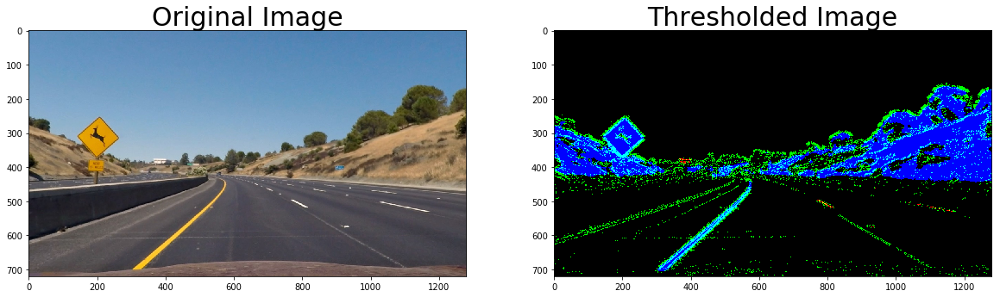

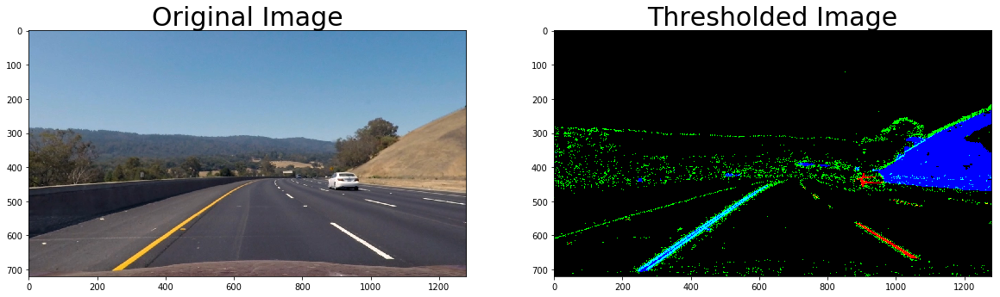

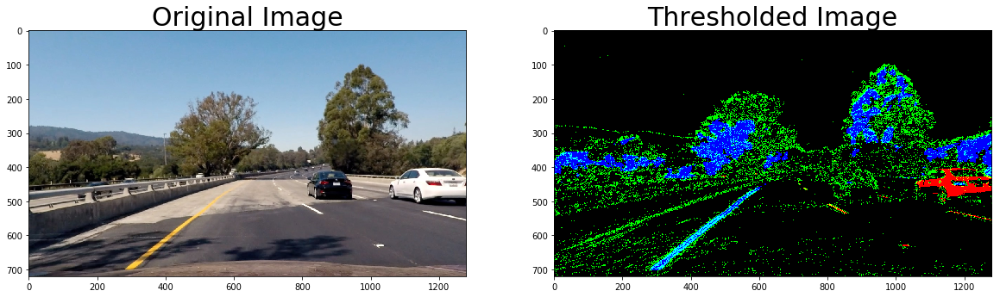

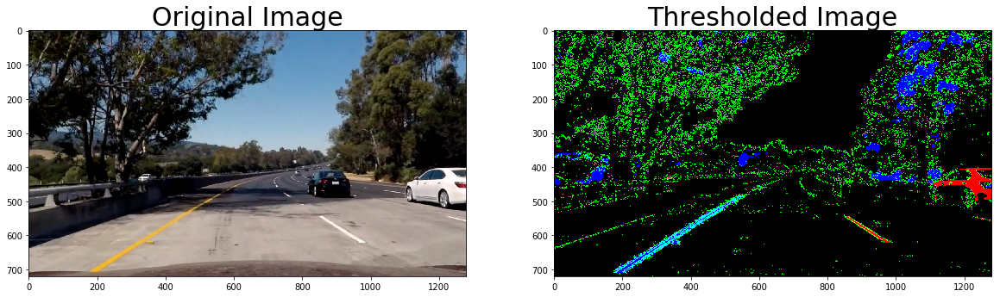

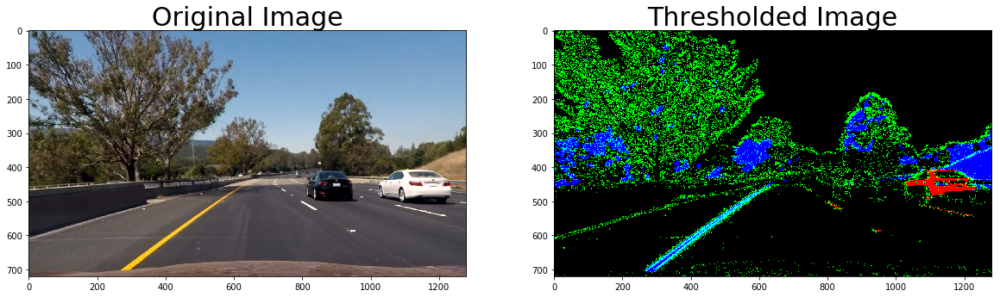

In [28]:
filenames = glob.glob('../test_images/*.jpg')

for image in [ cv2.imread(filename) for filename in filenames ]:
    undistorted = cv2.undistort(image, calibration.camera_matrix, calibration.distortion_coefficients, None)
    edges = get_edge_mask(undistorted, return_all_channels=True)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))

    ax1.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    ax2.imshow(edges)

    ax1.set_title('Original Image', fontsize=30)
    ax2.set_title('Thresholded Image', fontsize=30)


### Generate Video

In [ ]:
video_path = '../project_video.mp4'
output_path = '../output.mp4'
tracker = LaneLineTracker(
    video_path, 
    calibration=calibration, 
    source_points=SOURCE_POINTS, 
    destination_points=DESTINATION_POINTS, 
    output_path=output_path
)
%time tracker.process_video()